# **Imports**

In [ ]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import inspect
from scipy import linalg
import math
from tqdm import tqdm

# **Loading videos and images**

In [ ]:
image1 = cv2.imread("/content/drive/MyDrive/asg2_cv/image1.jpg")
image2 = cv2.imread("/content/drive/MyDrive/asg2_cv/image2.jpg")

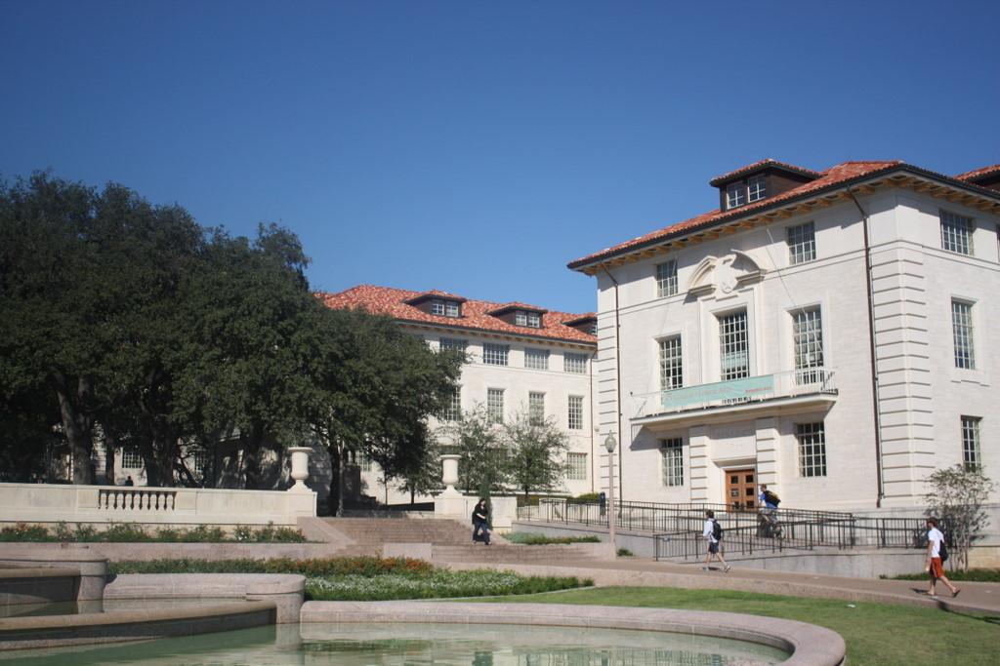

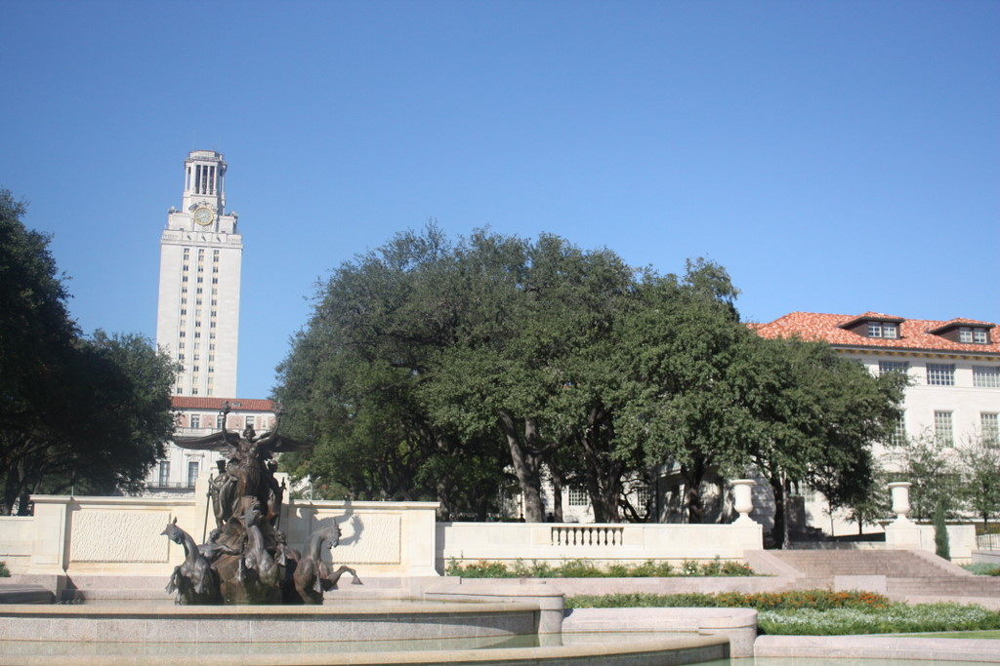

In [ ]:
cv2_imshow(image1)
cv2_imshow(image2)

In [ ]:
print(f"Dimensions of image1: {image1.shape}")
print(f"Dimensions of image1: {image2.shape}")

Dimensions of image1: (683, 1024, 3)
Dimensions of image1: (683, 1024, 3)


# **SIFT Descriptor**

In [ ]:
def sift(image):
  gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  sift = cv2.SIFT_create()
  keypoints, descriptors = sift.detectAndCompute(gray_image, None)
  sift_image = cv2.drawKeypoints(image, keypoints, 0)
  return sift_image, keypoints, descriptors

In [ ]:
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)

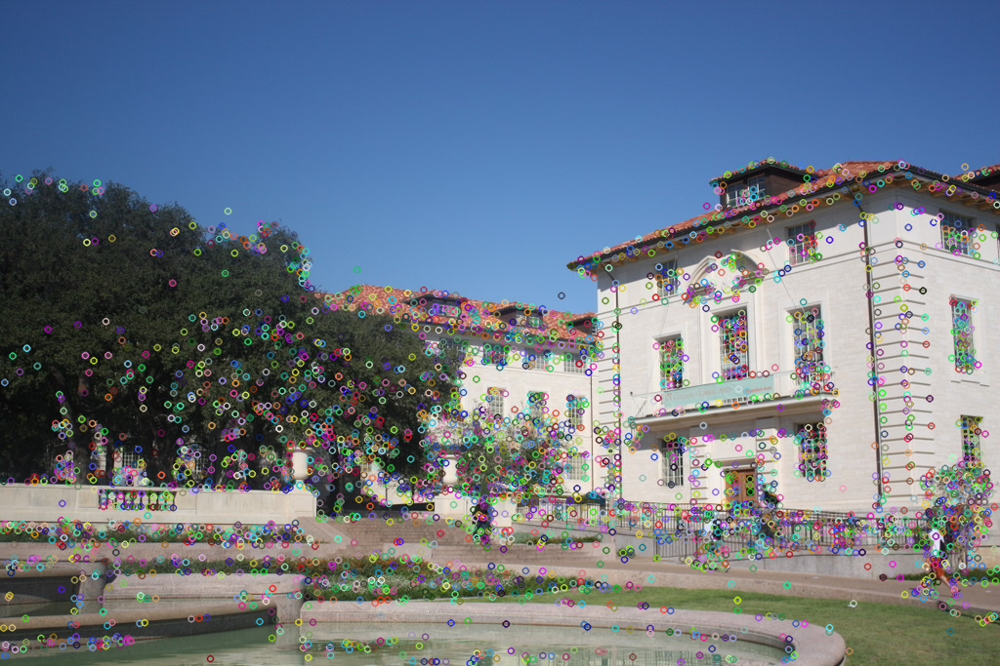

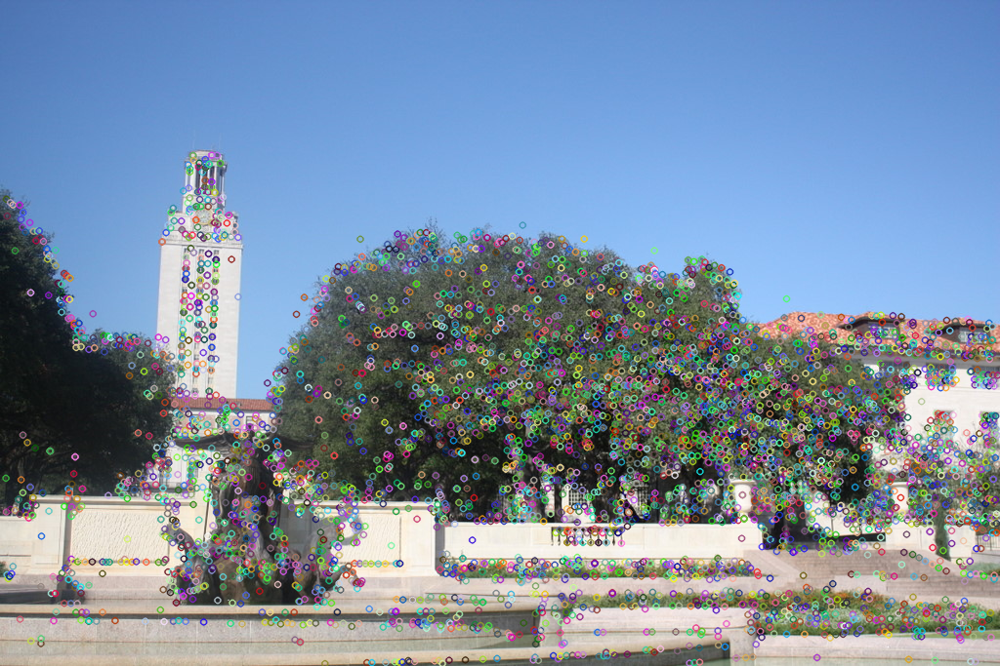

In [ ]:
cv2_imshow(sift_image1)
cv2_imshow(sift_image2)

# **Key Matching**

In [ ]:
def key_matching(descriptors1, descriptors2, nkp=50):
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(descriptors1, descriptors2, k=2)
    print(f"Number of matches before filtering = {len(matches)}")
    ratios = []
    for (i,j) in matches:
      ratios.append((i, i.distance/j.distance))
    ratios = sorted(ratios,key=lambda x:x[1])[0:nkp]
    final_matches = [x[0] for x in ratios]
    print(f"Number of matches after filtering = {len(final_matches)}")
    final_matches = sorted(final_matches, key=lambda x:x.distance)
    return final_matches

In [ ]:
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:50]
matched_img = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches, 0, flags=2)

Number of matches before filtering = 4195
Number of matches after filtering = 300


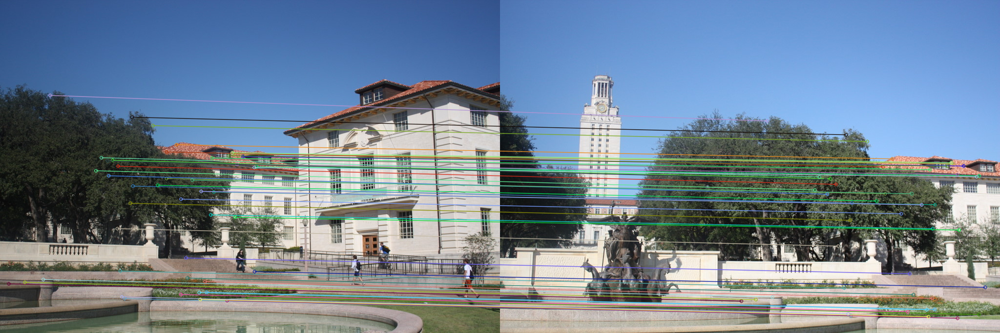

In [ ]:
cv2_imshow(matched_img)

# **Homography Matrix**

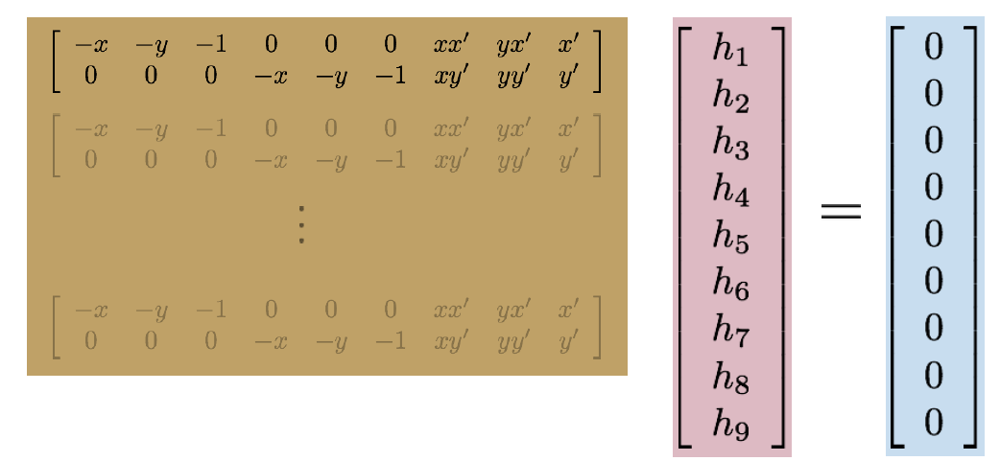

In [ ]:
def get_kp(matches):
  image1_points=[]
  image2_points=[]
  for m in matches:
    i = m.queryIdx
    j = m.trainIdx
    image1_points.append(keypoints1[i].pt)
    image2_points.append(keypoints2[j].pt)
  return image1_points, image2_points

In [ ]:
def constructA(image1_points,image2_points,start=0,end=50):
  A = np.zeros(((end-start)*2,9))
  for i in range(0,(end-start)*2,2):
    (x1,y1) = image1_points[i//2]
    (x2,y2) = image2_points[i//2]
    A[i] = np.array([-1*x1,-1*y1,-1,0,0,0,x1*x2,y1*x2,x2])
    A[i+1] = np.array([0,0,0,-1*x1,-1*y1,-1,x1*y2,y1*y2,y2])
  return A

In [ ]:
def get_homography(A):
  U, s, Vh = linalg.svd(A)
  H = Vh[-1,:] / Vh[-1,-1]
  H = H.reshape(3, 3)
  return H

In [ ]:
def get_new_points(points, H):
  new_points =[]
  for original_point in points:
    point = original_point.copy()
    point.append(1)
    point = np.array(point)
    point = point[...,np.newaxis]
    new_point = H @ point
    new_point = new_point/new_point[-1]
    new_points.append(new_point.T)
  new_points = np.array(new_points)[:,:,0:2]
  new_points = new_points.squeeze()
  return new_points

In [ ]:
def builtin_check(matches,H,point):
  image1_points2, image2_points2 = get_kp(matches)
  h, status = cv2.findHomography(np.array(image1_points2), np.array(image2_points2))
  transformedPoint1 = H @ np.array(point).transpose()
  transformedPoint1 /= transformedPoint1[-1]
  transformedPoint2 = h @ np.array(point).transpose()
  transformedPoint2 /= transformedPoint2[-1]
  print(f"Our function: {transformedPoint1}")
  print(f"Built-in function: {transformedPoint2}")
  if sum(abs(transformedPoint1-transformedPoint2))/2 <1:
    print("Acceptable Range")
  else:
    print("Too far off!")
  if len(h[abs(h - H) >20])==0:
    print("Almost no difference")
    return True
  return False

In [ ]:
def overlay(overlay_image, original_image, H,ptop):
  indices = [[i,j] for i in range(overlay_image.shape[1]) for j in range(overlay_image.shape[0])]
  new_points = get_new_points(indices,H)
  copy_image = original_image.copy()
  for i,(x,y) in enumerate(new_points):
    [x2,y2] = indices[i]
    combinations = [#[math.ceil(x),math.ceil(y)],
                    [math.ceil(x),math.floor(y)],
                    #[math.floor(x),math.ceil(y)],
                    [math.floor(x),math.floor(y)]]
    for u,v in combinations:
      if (u < original_image.shape[1] and v+ptop < original_image.shape[0] and u > 0 and v+ptop > 0):
        if sum(copy_image[v+ptop,u]) == 0 and sum(original_image[v+ptop,u])==0:
          copy_image[v+ptop,u] = overlay_image[y2,x2]
        elif sum(original_image[v+ptop,u])==0:
          copy_image[v+ptop,u] = (copy_image[v+ptop,u]+overlay_image[y2,x2])//2
  return copy_image

In [ ]:
#for bonus example
def overlay2(overlay_image, original_image, H,border,ptop):
  indices = [[i,j] for i in range(overlay_image.shape[1]) for j in range(overlay_image.shape[0])]
  new_points = get_new_points(indices,H)
  copy_image = original_image.copy()
  for i,(x,y) in enumerate(new_points):
    [x2,y2] = indices[i]
    combinations = [#[math.ceil(x),math.ceil(y)],
                    [math.ceil(x),math.floor(y)],
                    #[math.floor(x),math.ceil(y)],
                    [math.floor(x),math.floor(y)]]
    for u,v in combinations:
      if (u < original_image.shape[1] and v+ptop < original_image.shape[0] and u > 0 and v+ptop > 0):
        if sum(copy_image[v+ptop,u]) == 0 and u >= border:
          copy_image[v+ptop,u] = overlay_image[y2,x2]
        elif u>=border:
          copy_image[v+ptop,u] = (copy_image[v+ptop,u]+overlay_image[y2,x2])//2
  return copy_image

In [ ]:
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)
n_points = 20
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:n_points]
image1_points , image2_points = get_kp(matches)
A =constructA(image1_points,image2_points,start=0,end=n_points)
H = get_homography(A)

Number of matches before filtering = 4195
Number of matches after filtering = 300


In [ ]:
builtin_check(matches, H, [100,100,1])

Our function: [541.7143584  158.12250107   1.        ]
Built-in function: [541.58408323 157.97958647   1.        ]
Acceptable Range
Almost no difference


True

# **Padding**

In [ ]:
def padding(image1,image2,H):
  indices = [[i,j] for i in range(image1.shape[1]) for j in range(image1.shape[0])]
  new_points = get_new_points(indices,H)
  ptop = math.ceil(abs(min(new_points[:,1])))
  pbottom = math.ceil(max(max(new_points[:,1])-image2.shape[0],0))
  pright = math.ceil(max(max(new_points[:,0])-image1.shape[1],0))
  padding_right = np.zeros((image2.shape[0],pright,3))
  extended_image = image2.copy()
  extended_image = np.hstack((extended_image, padding_right))
  padding_top = np.zeros((ptop,extended_image.shape[1],3))
  extended_image = np.vstack((padding_top,extended_image))
  padding_bottom = np.zeros((pbottom,extended_image.shape[1],3))
  extended_image = np.vstack((extended_image,padding_bottom))
  return extended_image, ptop


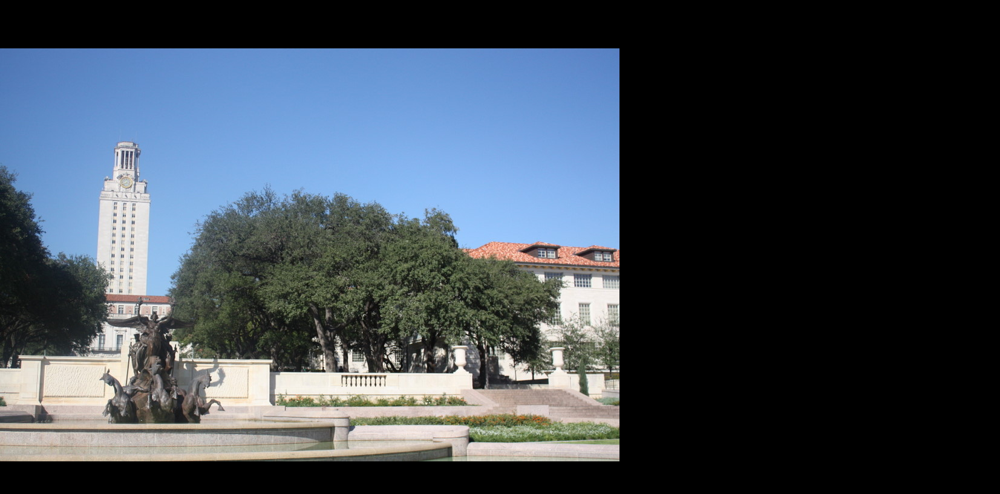

In [ ]:
#padding
extended_image,ptop = padding(image1,image2,H)
cv2_imshow(extended_image)

# **Forward Warping**

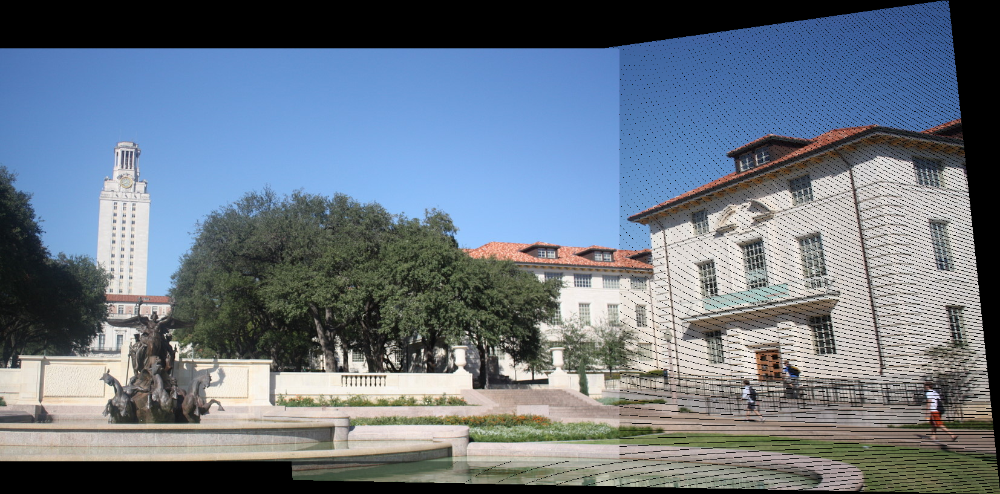

In [ ]:
forward_frame = overlay(image1,extended_image,H,ptop=ptop)
cv2_imshow(forward_frame)

# **Backward Warping**

In [ ]:
def backward_wrap(original_image, new_image, H,ptop):
  final_image = new_image.copy()
  indices = [[i,j] for i in range(0,final_image.shape[1]) for j in range(final_image.shape[0])]
  copy_indices = np.array(indices.copy())
  copy_indices[:,1] = np.array(indices)[:,1] - ptop
  new_points = get_new_points(copy_indices.tolist(),np.linalg.inv(H))
  for i,(x,y) in enumerate(new_points):
    [x0,y0] = indices[i]
    if sum(final_image[y0,x0])==0 and sum(new_image[y0,x0])==0:
      combinations = [[math.ceil(x),math.ceil(y)],
                  [math.ceil(x),math.floor(y)],
                  [math.floor(x),math.ceil(y)],
                  [math.floor(x),math.floor(y)]]
      for u, v in combinations:
        if u < original_image.shape[1] and v < original_image.shape[0] and u > 0 and v > 0:
          final_image[y0,x0]  = final_image[y0,x0] + abs( (1-abs(u-x)) *(1-abs(v-y)) ) *original_image[v,u]
    final_image[y0,x0] = np.round(final_image[y0,x0]).astype('int64')
  return final_image

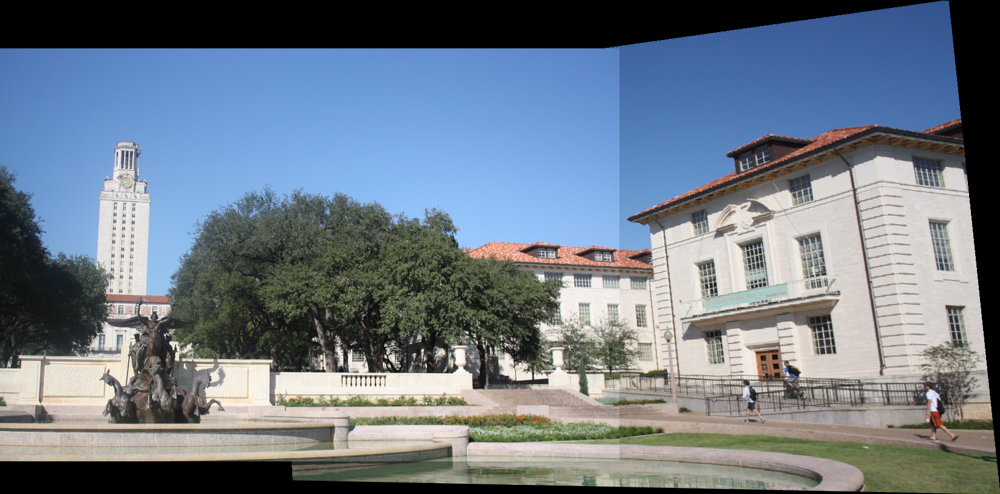

In [ ]:
final_frame = backward_wrap(image1,forward_frame,H,ptop)
cv2_imshow(final_frame)

# **Another Example**

Number of matches before filtering = 2552
Number of matches after filtering = 300


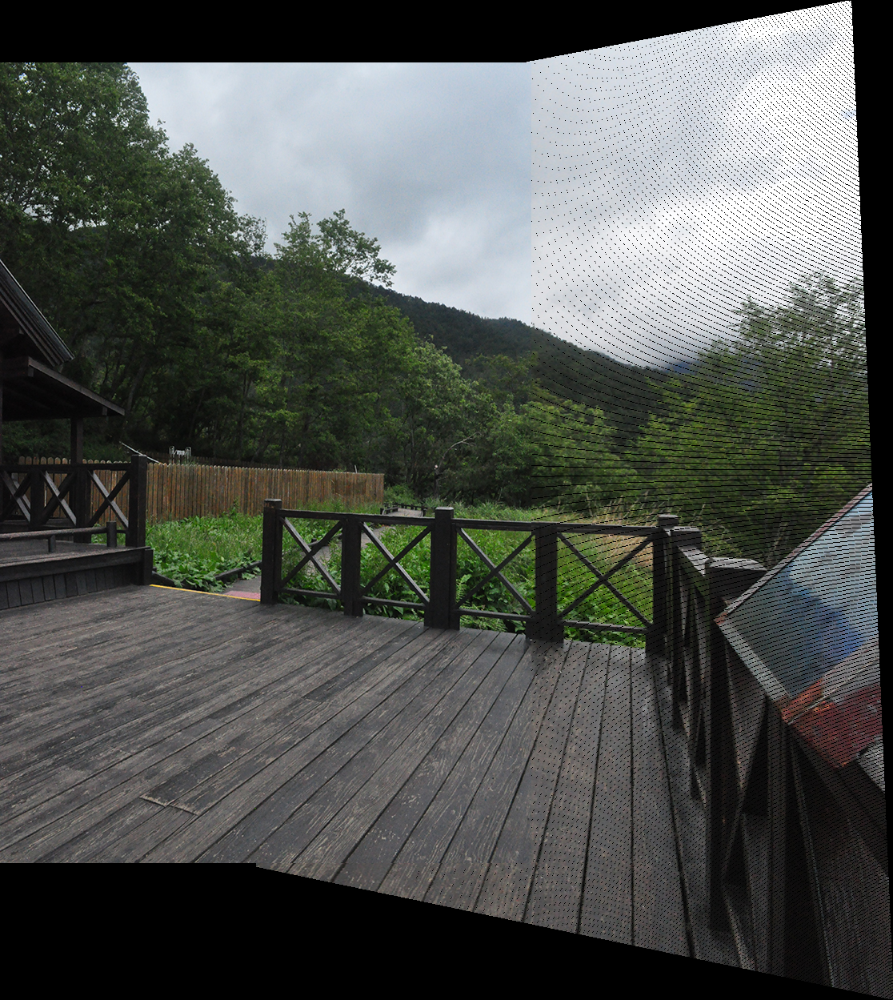

In [ ]:
image1 = cv2.imread("/content/drive/MyDrive/asg2_cv/extra2.jpg")
image2 = cv2.imread("/content/drive/MyDrive/asg2_cv/extra1.jpg")
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)
n_points = 20
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:n_points]
image1_points , image2_points = get_kp(matches)
A =constructA(image1_points,image2_points,start=0,end=n_points)
H = get_homography(A)
extended_image,ptop = padding(image1,image2,H)
forward_frame = overlay(image1,extended_image,H,ptop)
cv2_imshow(forward_frame)

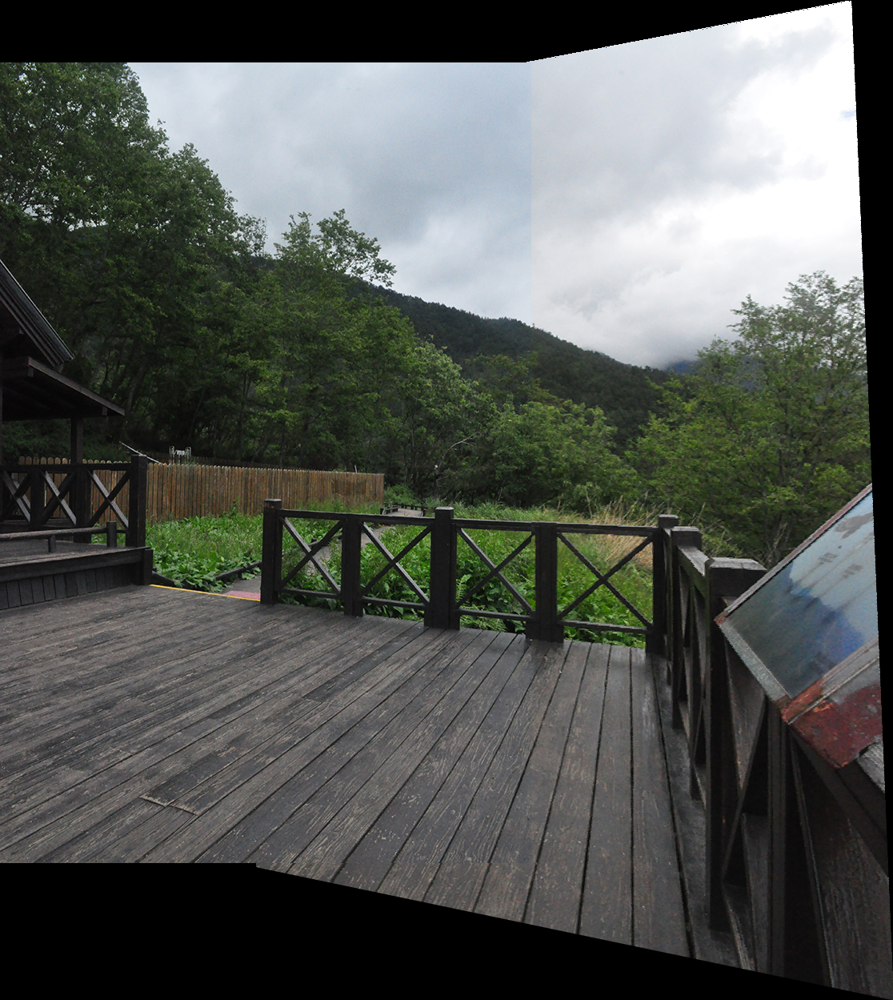

In [ ]:
final_frame = backward_wrap(image1,forward_frame,H,ptop)
cv2_imshow(final_frame)

#**Bonus**

Number of matches before filtering = 1004
Number of matches after filtering = 300


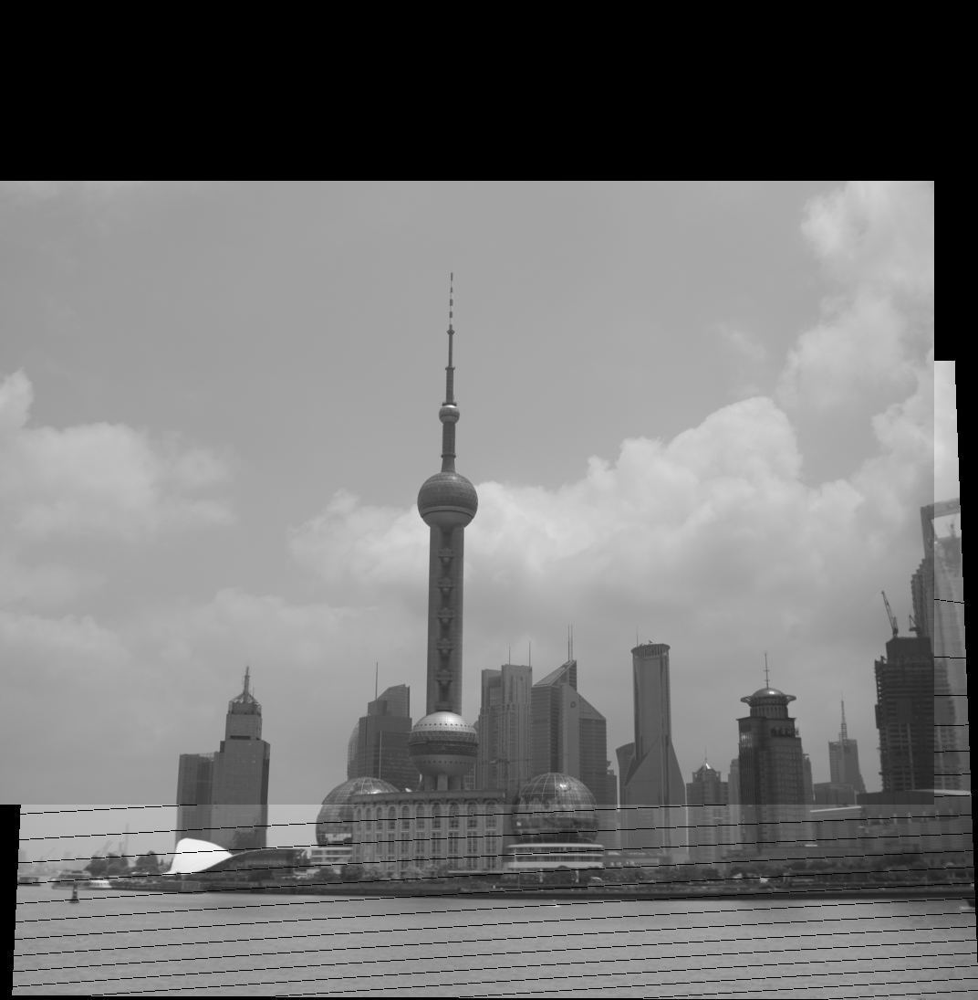

In [ ]:
image1 = cv2.imread("/content/drive/MyDrive/asg2_cv/shanghai-21.png")
image2 = cv2.imread("/content/drive/MyDrive/asg2_cv/shanghai-22.png")
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)
n_points = 20
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:n_points]
image1_points , image2_points = get_kp(matches)
A =constructA(image1_points,image2_points,start=0,end=n_points)
H = get_homography(A)
extended_image,ptop = padding(image1,image2,H)
forward_frame = overlay(image1,extended_image,H,ptop=ptop)
cv2_imshow(forward_frame)

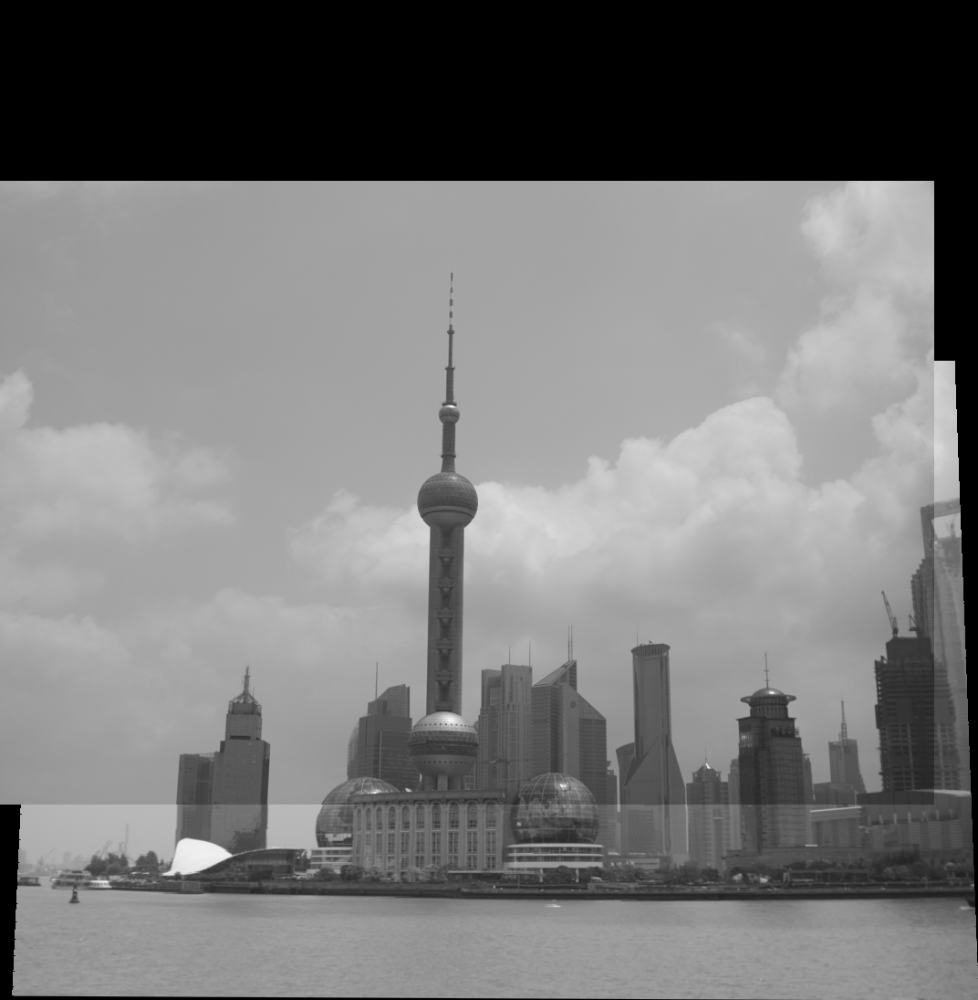

In [ ]:
final_frame = backward_wrap(image1,forward_frame,H,ptop=ptop)
cv2_imshow(final_frame)

Number of matches before filtering = 1136
Number of matches after filtering = 300


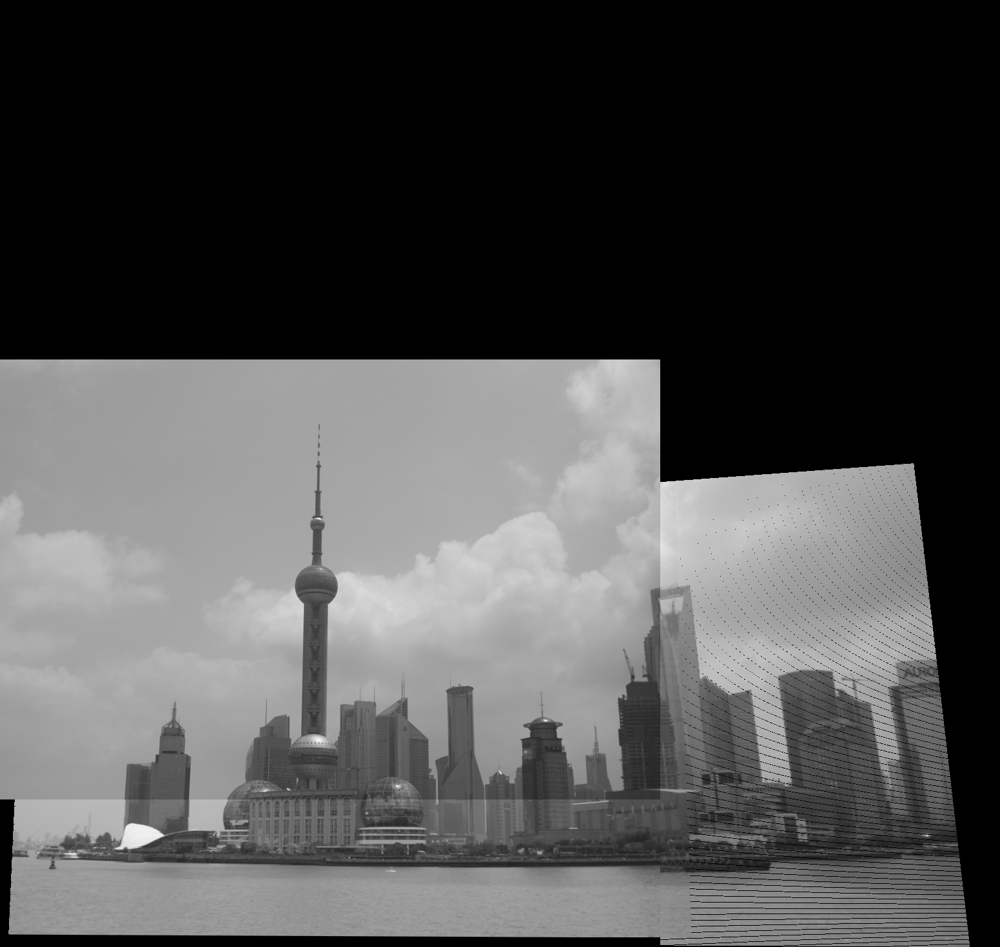

In [ ]:
image2 = final_frame.copy()
image1 = cv2.imread("/content/drive/MyDrive/asg2_cv/shanghai-23.png")
image2 = image2.astype('uint8')
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)
n_points = 20
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:n_points]
image1_points , image2_points = get_kp(matches)
A =constructA(image1_points,image2_points,start=0,end=n_points)
H = get_homography(A)
extended_image,ptop = padding(image1,image2,H)
forward_frame = overlay2(image1,extended_image,H,image1.shape[1],ptop)
cv2_imshow(forward_frame)

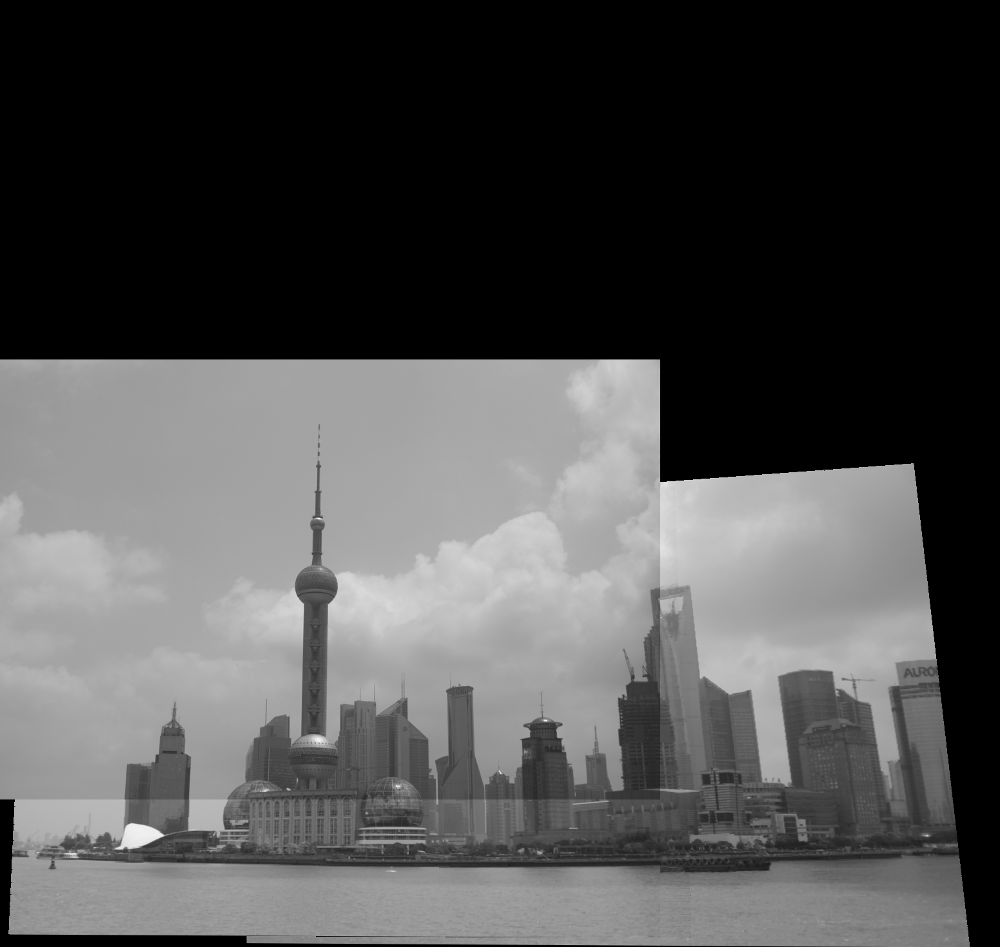

In [ ]:
final_frame = backward_wrap(image1,forward_frame,H,ptop)
cv2_imshow(final_frame)

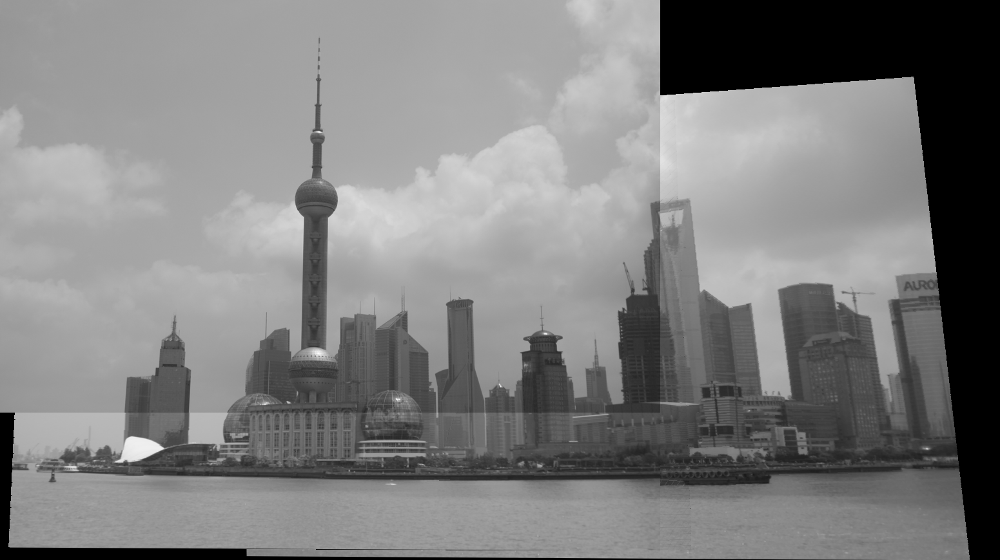

In [ ]:
copy_image = final_frame[600:,:]
copy_image.shape
cv2_imshow(copy_image)

# **Bonus** (different order)

Number of matches before filtering = 1136
Number of matches after filtering = 300


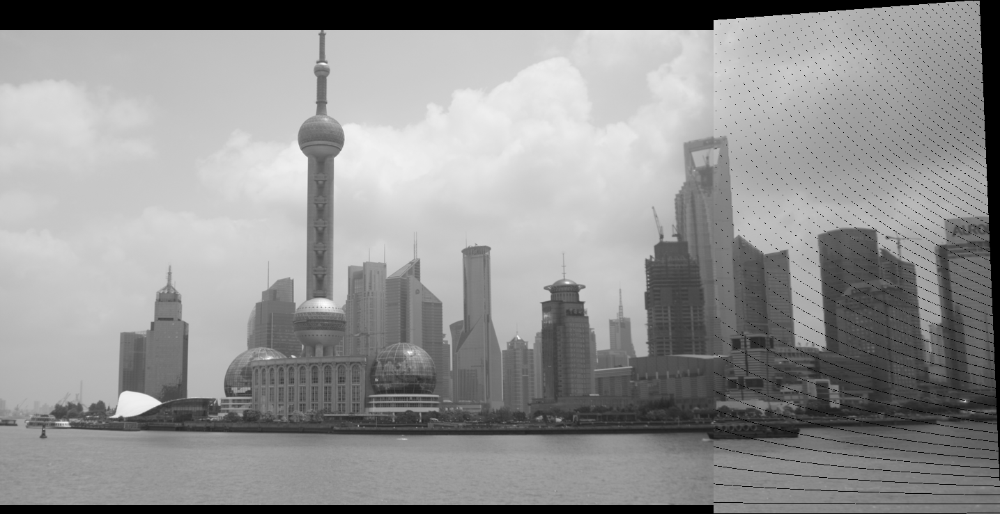

In [ ]:
image1 = cv2.imread("/content/drive/MyDrive/asg2_cv/shanghai-23.png")
image2 = cv2.imread("/content/drive/MyDrive/asg2_cv/shanghai-21.png")
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)
n_points = 20
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:n_points]
image1_points , image2_points = get_kp(matches)
A =constructA(image1_points,image2_points,start=0,end=n_points)
H = get_homography(A)
extended_image,ptop = padding(image1,image2,H)
forward_frame = overlay(image1,extended_image,H,image2.shape[1],ptop)
cv2_imshow(forward_frame)

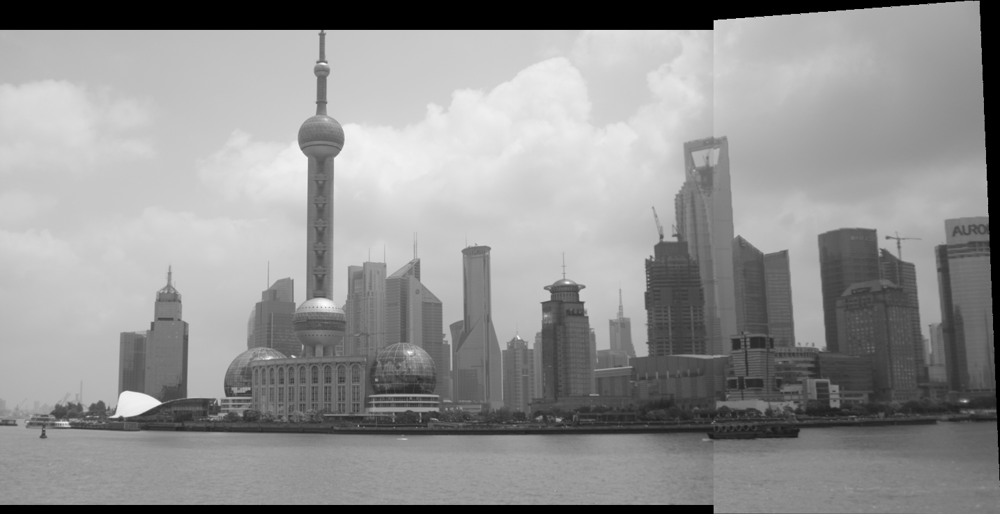

In [ ]:
final_frame = backward_wrap(image1,forward_frame,H,image2.shape[1],ptop)
cv2_imshow(final_frame)

Number of matches before filtering = 464
Number of matches after filtering = 300


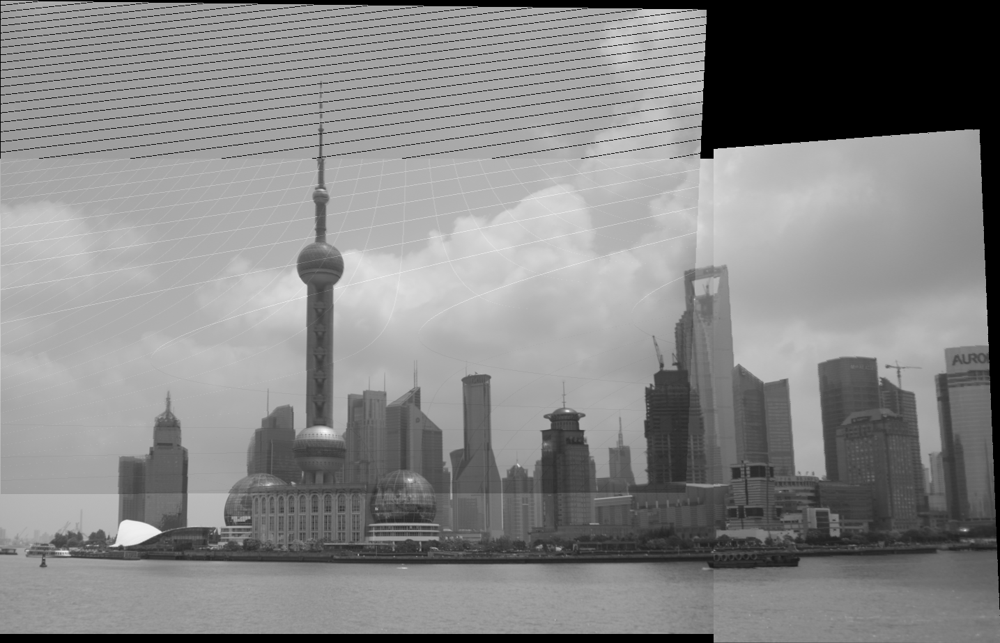

In [ ]:
image2 = final_frame.copy()
image1 = cv2.imread("/content/drive/MyDrive/asg2_cv/shanghai-22.png")
image2 = image2.astype('uint8')
sift_image1, keypoints1, descriptors1 = sift(image1)
sift_image2, keypoints2, descriptors2 = sift(image2)
n_points = 20
matches = key_matching(descriptors1, descriptors2,nkp=300)[0:n_points]
image1_points , image2_points = get_kp(matches)
A =constructA(image1_points,image2_points,start=0,end=n_points)
H = get_homography(A)
extended_image,ptop = padding(image1,image2,H)
forward_frame = overlay2(image1,extended_image,H,0,ptop)
cv2_imshow(forward_frame)

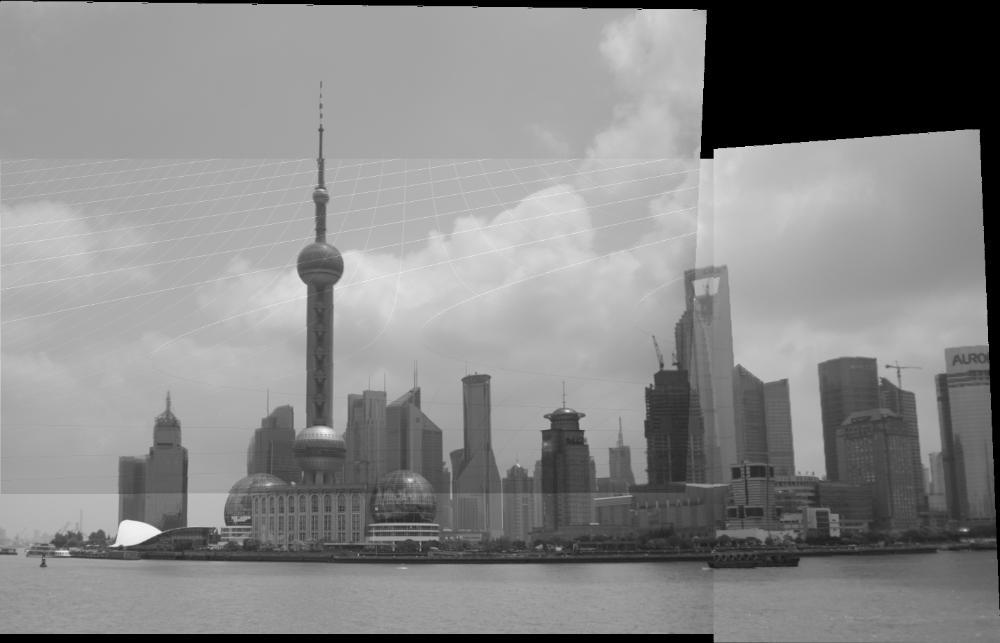

In [ ]:
final_frame = backward_wrap(image1,forward_frame,H,ptop)
cv2_imshow(final_frame)